# Un Enfoque Dinámico para Galgas Extensiométicas.


## Objetivos

1. **Comprender el funcionamiento de los mínimos cuadrados recursivos (RLS) en un caso práctico**: Explorar el algoritmo de mínimos cuadrados recursivos mediante la simulación de datos provenientes de una galga extensiométrica, considerada como un sistema dinámico de *masa-resorte-amortiguador*, permitiendo observar cómo los RLS se aplican para la estimación de parámetros.

2. **Aplicar los mínimos cuadrados recursivos para estimar parámetros físicos del sistema**: A través de los datos simulados, estimar los parámetros dinámicos en tiempo discreto y, posteriormente, deducir los parámetros físicos de la galga extensiométrica, como la masa que se coloca sobre ella y que se busca estimar con precisión.

3. **Desarrollar la habilidad de emplear los mínimos cuadrados recursivos en aplicaciones prácticas**: Familiarizarse con la implementación y ajuste del algoritmo en Python para llevar a cabo estimaciones en sensores similares, proporcionando las bases necesarias para extender su uso a aplicaciones reales.

4. **Comprender cómo los mínimos cuadrados recursivos aportan inteligencia a los sensores**: Analizar cómo el uso del algoritmo permite que un simple sensor de posición, mediante los mínimos cuadrados recursivos, pueda estimar la masa aplicada en tiempo real, incluso durante el transitorio sin necesidad de esperar hasta el estado estacionario, como ocurre con la mayoría de los sensores de masa o básculas. Además, se explora cómo este enfoque permite también la estimación de otros parámetros del sistema, ampliando su aplicabilidad en sistemas de control automático.

## Introducción

Las galgas extensiométricas son ampliamente utilizadas en aplicaciones de medición de deformación, ya que permiten transformar cambios físicos en variaciones de resistencia eléctrica. A pesar de ser catalogadas como sensores resistivos, las galgas poseen una dinámica inherente que debe considerarse en aplicaciones de alta precisión. Aunque comúnmente se les modela como elementos estáticos, en muchas situaciones prácticas, su comportamiento dinámico afecta la precisión de las mediciones, especialmente cuando se integran en sistemas que involucran cambios rápidos o fuerzas en movimiento.


```{figure} images/galga.png
---
height: 300px
name: directive1-fig
---
Galga extensiométrica. Imagen obtenida de {cite}`metoree_strain_gauge`.
```




Un caso típico de esto se observa en basculas, que son básicamente sensores de pesaje, donde la galga extensiométrica forma parte de un sistema de segundo orden, que puede describirse mediante un modelo **masa-resorte-amortiguador**. Al modelar correctamente esta dinámica, es posible capturar mejor el comportamiento transitorio del sistema y mejorar la estimación de las fuerzas aplicadas.

En este capítulo se busca mostrar la dinámica de la galga extensiométrica en el contexto de un modelo **masa-resorte-amortiguador**, específicamente cómo trabajar con dicha dinámica para la estimación de la masa, utilizando técnicas de estimación de parámetros mediante **mínimos cuadrados recursivos**. 

Se comenzará describiendo el modelo **masa-resorte-amortiguador** en su forma más sencilla.


```{figure} images/sys.png
---
height: 300px
name: directive1-fig
---
Sistema Masa-Resorte-Amortiguador. Imagen obtenida de {cite}`item24sistemamasaresorteamortiguador`.
```



$$m\frac{d^2x(t)}{dt^2}+b\frac{dx(t)}{dt}+kx(t)=F(t)$$

donde $m$ es la masa del sistema, $b$ es el coeficiente de fricción viscosa, $k$ es la constante de elasticidad del resorte, $F(t)$ la fuerza de entrada y $x(t)$ el desplazamiento presentado debido a $F(t)$.

Como nos presenta {cite}`gustavo_thesis`, un modelo masa-resorte-amortiguador que describe el comportamiento dinámico de una galga extensiométrica es

$$\frac{d^2x(t)}{dt^2}\left(u(t)+m \right)+b\frac{dx(t)}{dt}+kx(t)=(u(t)+m)g$$

donde $m$ es la propia masa del sensor, $b$ es el coeficiente de fricción viscosa, $k$ es la constante de elasticidad del resorte, $g$ es la constante de gravedad y $u(t)$ es la masa desconocida, siendo aquella masa que se quiere cuantificar.

## Estimación de parámetros en Tiempo Discreto con Mínimos Cuadrados Recursivos

Tomando como referencia los resultados experimentales que validan el comportamiento dinámico del sensor {cite}`gustavo_thesis`, se utiliza el modelo en espacio de estados del sensor:

$$\dot{x}(t) =\left[ \begin{array}{cc}
0 &1 \\
\frac{-k}{m+M} & \frac{-b}{m+M}
\end{array}\right]x(t)+\left[ \begin{array}{c}
0  \\
-g
\end{array}\right]u(t)$$

$$y(t) = \left[ \begin{array}{cc}
-1 &0
\end{array}\right]x(t)$$

con $m=0.015[kg]$, $k=500[N/m]$, $b = 0.5[N\cdot s /m]$,  y $g = 9.81[m/s^2]$. Estos son los parámetros a utilizar para simular la dinámica del sensor.

```{note}
Si se desea realizar modificaciones en el código, favor de ejecutar la siguiente celda para la generación de datos e importación de las bibliotecas necesarias. Una vez ejecutada esta, es posible ejecutar las siguientes con las modificaciones requeridas.
```

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from scipy import signal
from control.matlab import *
from matplotlib.animation import FuncAnimation
from IPython.display import HTML, display, Math

En la siguiente sección de código, se genera la señal de salida, la cual será utilizada como la medición realizada para la estimación en *tiempo real*.

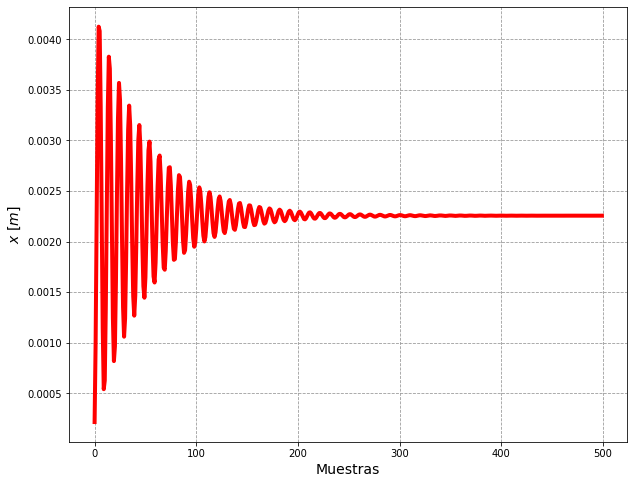

In [2]:

# Parámetros físicos del sensor
kn = 500 
b = 0.5
m = 0.015
M = 0.1
g = 9.81

# Modelo en espacio de estados
A = np.array([[0, 1], [-kn / (m + M), -b / (m + M)]])
B = np.array([[0], [-g]])
C = np.array([[-1, 0]])
D = np.array([[0]])

# Sistema en tiempo continuo. Representación en espacio de estados
sys_cont = signal.StateSpace(A, B, C, D)

# Tiempo de muestreo y discretización por el método Tustin
T_s = 0.01
sys_disc = sys_cont.to_discrete(T_s, 'tustin')

# Generando los datos de respuesta al escalón
t = np.arange(0, 5, T_s)  # Tiempo de simulación
__, y = signal.dstep(sys_disc, t=t)  # Respuesta discreta al escalón
y = np.squeeze(y)

# Gráfica de los datos generados
plt.figure(figsize=(10, 8))
plt.plot(y, 'r-', linewidth=4)
plt.grid(True, linestyle='--', color=(0.6, 0.6, 0.6))
plt.xlabel('Muestras', fontsize=14)
plt.ylabel(r'$x\ [m]$', fontsize=14)
plt.show()

Para comenzar con el desarrollo del algoritmo, se debe tener en cuenta que el regresor no será unitario, como en el capítulo anterior.  Por lo tanto, es necesario *proponer un modelo en tiempo discreto*. En particular, al discretizar la función de transferencia del sistema  $H(s)$, se obtiene un modelo con estructura ARMA (AutoRegressive Moving Average), expresado como:

$$y(k) = b_0u(k) + b_1u(k-1) + b_2u(k-2) - a_1y(k-1) -a_2y(k-2),$$

donde los parámetros de la ecuación en diferencias se obtienen a partir del vector de parámetros $\hat{\theta_k}$Dada la definición del regresor y considerando que se estimarán 5 parámetros, este debe tener dicha dimensión. Por lo tanto, el regresor puede definirse de la siguiente manera:

$$\phi = \begin{bmatrix}
-y(k-2) \\
-y(k-1) \\
u(k-2) \\
u(k-1) \\
u(k)
\end{bmatrix}$$

de esta forma, se construirá el regresor. Esto se puede observar en la siguiente sección de código, donde se inicializa el algoritmo y se aplica.

In [4]:
# Factor de olvido para modificar
lambda_ = 0.75

# Inicialización de valores para el algoritmo RLS
P = 1000 * np.eye(5)
theta = np.zeros(5)
estimation = list()

# Simulación de datos de ejemplo
length = len(y)
# Configuración de la gráfica
fig, ax = plt.subplots(figsize=(10, 8))
ax.grid(True, color=[0.6, 0.6, 0.6], linestyle='--')
ax.set_xlim(0, 250)
ax.set_ylim(min(y)-0.0001, max(y)+0.0001)
ax.set_xlabel('Muestras', fontsize=14)
ax.set_ylabel(r'$x\ [m]$', fontsize=14)

# Inicialización para el gráfico
plot_output, = ax.plot([], [], 'r-', linewidth=4, label=r'$x(t)$')
plot_estimation, = ax.plot([], [], 'b--', linewidth=4, label=r'$\hat{x}(t)$')
ax.legend(fontsize=14)


# Función de actualización para cada frame de la animación
def update_rls(k):
    global theta, P

    # Definimos el vector de regresión
    phi = np.array([-y[k - 2], -y[k - 1], 1, 1, 1])

    # Error de predicción
    epsilon = y[k] - np.dot(phi.T, theta)

    # Cálculo de la matriz de covarianza
    K = np.dot(P, phi) / (lambda_ + np.dot(np.dot(phi.T, P), phi))

    # Ganancia de Kalman
    P = (1 / lambda_) * (P - (np.dot(np.dot(P, np.outer(phi, phi)), P)) / (lambda_ + np.dot(np.dot(phi.T, P), phi)) )

    # Actualización del vector de parámetros
    theta = theta + (K * epsilon)

    # Guardamos la estimación realizada
    estimation.append(np.dot(phi.T, theta))

    # Actualizamos la gráfica
    plot_estimation.set_data(range(len(estimation)), estimation)
    plot_output.set_data(range(k + 1), y[:k + 1])

    return  plot_estimation, plot_output

# Configuración de la animación
ani = FuncAnimation(fig,  update_rls, frames=range(2, 250), blit=True, interval=50)

plt.close(fig) 
HTML(ani.to_jshtml())

Se puede observar en la sección de código anterior que los valores del regresor de la entrada son unitarios, lo cual se debe a que la entrada corresponde a un escalón unitario. Por otro lado, debido a limitaciones de la animación, esta solo se realiza con algunas muestras. No obstante, en la siguiente sección de código se lleva a cabo la estimación utilizando todas las muestras disponibles.

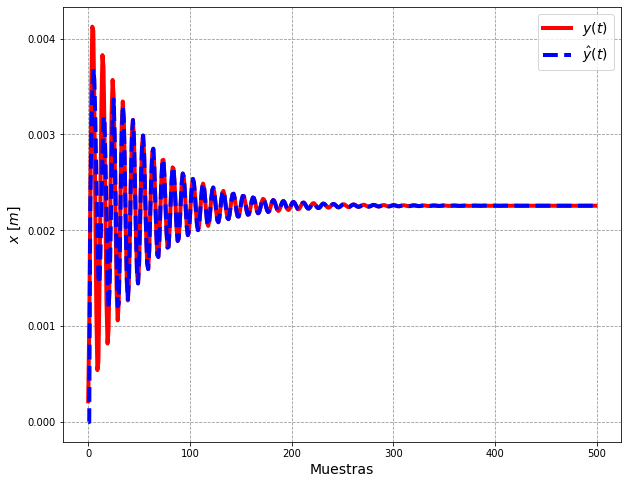

In [5]:

# Factor de olvido para modificar
lambda_ = 0.75

# Inicialización de valores para el algoritmo RLS
P = 1000 * np.eye(5)
theta = np.zeros(5)
estimation = [0, 0]
a2 = [0, 0] 

for k in range (2, len(y)):

    # Definimos el vector de regresión
    phi = np.array([-y[k - 2], -y[k - 1], 1, 1, 1])

    # Error de predicción
    epsilon = y[k] - np.dot(phi.T, theta)

    # Ganancia de Kalman
    K = np.dot(P, phi) / (lambda_ + np.dot(np.dot(phi.T, P), phi))

    # Cálculo de la matriz de covarianza
    P = (1 / lambda_) * (P - (np.dot(np.dot(P, np.outer(phi, phi)), P)) / (lambda_ + np.dot(np.dot(phi.T, P), phi)) )

    # Actualización del vector de parámetros
    theta = theta + (K * epsilon)

    # Guardamos la estimación realizada
    estimation.append(np.dot(phi.T, theta))

    a2.append(theta[0])

# Gráfica de los datos generados
plt.figure(figsize=(10, 8))
plt.plot(y, 'r-', linewidth=4, label=r'$y(t)$')
plt.plot(estimation, 'b--', linewidth=4, label=r'$\hat{y}(t)$')
plt.grid(True, linestyle='--', color=(0.6, 0.6, 0.6))
plt.xlabel('Muestras', fontsize=14)
plt.ylabel(r'$x\ [m]$', fontsize=14)
plt.legend(fontsize=14)
plt.show()


A continuación, observemos la función de transferencia en tiempo discreto obtenida utilizando el módulo `signal` de la biblioteca `SciPy` de `Python`:

In [6]:
# Convertir el sistema discretizado en espacio de estados a función de transferencia
num_p, den_p = signal.ss2tf(sys_disc.A, sys_disc.B, sys_disc.C, sys_disc.D)

print("Numerador:", num_p)
print("Denominador:", den_p)

Numerador: [[0.00021695 0.0004339  0.00021695]]
Denominador: [ 1.         -1.57692308  0.96153846]


La función de transferencia obtenida es:

$$H(z) = \frac{0.00021695z^2 + 0.0004339z + 0.00021695}{z^2 - 1.57692308 z + 0.96153846}$$

Es importante recordar que, mediante los mínimos cuadrados recursivos, se estiman los coeficientes del modelo ARMA presentado previamente. Estos coeficientes forman parte de la función de transferencia en tiempo discreto del sistema. Es decir, a partir de los coeficientes estimados, es posible construir directamente la función de transferencia en tiempo discreto del sistema. Los coeficientes estimados son:

In [7]:
print("Vector de parámetros estimados:", theta)

Vector de parámetros estimados: [ 9.61538423e-01 -1.57692303e+00  2.89269081e-04  2.89269288e-04
  2.89269353e-04]


En función de cómo se construyó el regresor, la función de transferencia en tiempo discreto estimada es:

$$H(z) = \frac{0.0002893z^2 + 0.0002893z + 0.0002893}{z^{2} - 1.57692303z + 0.961538423}$$



A continuación, se calculará el error absoluto porcentual (EAP) de la estimación de los coeficientes de la función de transferencia.

In [8]:
# Cálculos de error
error_a1 = abs((den_p[1] - theta[1]) / den_p[1]) * 100
error_a2 = abs((den_p[2] - theta[0]) / den_p[2]) * 100
error_b0 = abs((num_p[0,2] - theta[4]) / num_p[0,1]) * 100
error_b1 = abs((num_p[0,1] - theta[3]) / num_p[0,1]) * 100
error_b2 = abs((num_p[0,0] - theta[2]) / num_p[0,2]) * 100

# Impresión con LaTeX
display(Math(f"\\text{{Error del coeficiente }} a_1: {error_a1:.8f}\\%"))
display(Math(f"\\text{{Error del coeficiente }} a_2: {error_a2:.8f}\\%"))
display(Math(f"\\text{{Error del coeficiente }} b_0: {error_b0:.8f}\\%"))
display(Math(f"\\text{{Error del coeficiente }} b_1: {error_b1:.8f}\\%"))
display(Math(f"\\text{{Error del coeficiente }} b_2: {error_b2:.8f}\\%"))


<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

De esto se puede concluir que la estimación de los coeficientes $a_i$ es correcta y precisa. Sin embargo, la estimación de los coeficientes $b_j$ presenta un error mayor.


## Estimación de Parámetros en Tiempo Continuio a partir de los Estimados en Tiempo Discreto.

De manera general podemos podemos considerar la siguiente estructura de función de transferencia $H(s)$:

$$H(s) = \frac{\kappa}{s^2 + \alpha s + \beta } \quad (1)$$

donde $\kappa$, $ \alpha$ y $ \beta$, son los coeficientes de $H(s)$. Esta representación nos será de utilidad posteriormente.

Por otra parte, si consideramos que la masa desconocida $u(t) = Mu_{u}(t)$, donde $u_{u}(t)$ es un escalón unitario, podemos decir que la función de transferencia es


$$H(s) = \frac{g}{s^2 + \frac{b}{m+M}s + \frac{k}{m+M}} \quad (2)$$



In [9]:
def d2c_bilineal(theta, Ts):
    """
    Esta función retorna los coeficientes de una función de transferencia en tiempo continuo,
    a partir de un vector de parámetros estimados en tiempo discreto. Dicha conversión de 
    discreto a continuo es mediante el Método Tustin.

    Parámetros:
    theta : ndarray
        Vector de parámetros estimados.
    Ts : float
        Tiempo de muestreo (s).

    Retorna:
    _ : ndarray
        Vector de parámetros de la función de transferencia en tiempo continuo (1 x 5).
    """
    matrix_coefs = np.array([[2/Ts, (1 - (2/theta[1])), 0, 0, 0],
                             [((2/Ts) + (2/(theta[0] * Ts))), (1 - (1/theta[0])), 0, 0, 0],
                             [2/Ts, 1, -(4/(theta[4] * (Ts**2))), -(2/(theta[4] * Ts)), -(1/theta[4])],
                             [2/Ts, 1, (8/(theta[3] * (Ts**2))), 0, -(2/(theta[3]))],
                             [2/Ts, 1, -(4/(theta[2] * (Ts**2))), 2/(theta[2] * Ts), -(1/theta[2])]])
    
    vect = np.array([-(4/(Ts**2))*((theta[1] + 2)/(theta[1])),
                     (4/(Ts**2))*((1 - theta[0])/(theta[0])),
                     -(4/(Ts**2)),
                     -(4/(Ts**2)),
                     -(4/(Ts**2))])
    
    return np.linalg.solve(matrix_coefs, vect)

hat_hs = d2c_bilineal(theta, T_s)
print("Coeficientes de la función de transferencia H(s) estimada: ", hat_hs)

Coeficientes de la función de transferencia H(s) estimada:  [4.34783052e+00 4.34782635e+03 8.17499782e-05 3.07672101e-08
 9.81000059e+00]


La función en tiempo continuo estimada $\hat{H}(s)$ es:

$$\hat{H}(s) = \frac{0.00008175s^2 + 0.000000031s + 9.81000059}{s^2 + 4.34783052s + 4347.82635},$$

como se puede observar, en la función de transferencia estimada $\hat{H}(s)$, aparecen dos ceros finito, sin embargo en la teórica estos se encuentran en infinito. Sin embargo, al observar la función de transferencia estimada, es posible despreciar los términos  $s^2$ y $s$, ya que sus coeficientes son prácticamente cero. De este modo, la función de transferencia estimada se puede expresar como:

$$\hat{H}(s) = \frac{9.81000059}{s^2 + 4.34783052s + 4347.82635}$$

Mientras que la función de transferencia real del sistema es:

$$H(s) = \frac{9.81}{s^2 + 4.347826s + 4347.82608}$$

Al comparar ambas expresiones, se puede observar, mediante simple inspección, que la estimación de la función de transferencia del sistema es correcta y precisa.

Recapitulando lo expuesto hasta el momento, mediante mediciones, fue posible reconstruir el modelo dinámico del sensor (galga extensiométrica) utilizando una estimación paramétrica en tiempo discreto. A partir de esta estimación, y con los coeficientes de la función de transferencia estimada en tiempo continuo, es posible recuperar los valores de los parámetros físicos del modelo. A continuación, se mostrará cómo realizar este proceso.

Por simple inspección, apoyandonos de las ecuaciones ($1$) y ($2$), podemos ver que el coeficiente estimado $\hat{\kappa}$, es:

$$\hat{\kappa} = \hat{g}$$

In [10]:
g_est = hat_hs[4]
coef_a1 = hat_hs[0]
coef_a0 =  hat_hs[1]
display(Math(f"\\text{{Parámetro estimado }} \\hat{{g}} : {g_est:.8f} \\; \\left[ \\mathrm{{\\frac{{m}}{{s^2}}}} \\right]"))
display(Math(f"\\text{{Parámetro real }} g : {g:.8f} \\; \\left[ \\mathrm{{\\frac{{m}}{{s^2}}}} \\right]"))
error_g = abs((g - g_est) / g) * 100
display(Math(f"\\text{{Error del parámetro físico  }} g: {error_g:.8f}\\%"))

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

En este caso, se llevará a cabo un **proceso de calibración**,donde la entrada de nuestro sensor es conocida, es decir tenemos conocimiento de la amplitud $M$, y podemos medir la masa inherente del sensor $m$. De esta manera, conocemos la masa total del sistema, que es la suma de ambas, es decir, $m + M$. Una vez obtenidos estos datos, podemos determinar los parámetros físicos de la siguiente manera:

$$\hat{b} = \hat{\alpha} \cdot (\hat{m} + M)$$
$$\hat{k} = \hat{\beta} \cdot (\hat{m}+ M)$$

In [11]:
b_est = coef_a1 * (m + M)
k_est = coef_a0 * (m + M)
error_b = abs((b - b_est) / b) * 100
error_k = abs((kn - k_est) / kn) * 100

display(Math(f"\\text{{Parámetro estimado }} \\hat{{b}} : {b_est:.8f} \\; \\left[ \\mathrm{{\\frac{{N\\cdot m}}{{s}}}} \\right]"))
display(Math(f"\\text{{Parámetro real }} b : {b:.8f} \\; \\left[ \\mathrm{{\\frac{{N\\cdot m}}{{s}}}} \\right]"))
display(Math(f"\\text{{Error del parámetro físico  }} b: {error_b:.8f}\\%"))
display(Math(f"\\text{{Parámetro estimado }} \\hat{{k}} : {k_est:.8f} \\; \\left[ \\mathrm{{\\frac{{N}}{{m}}}} \\right]"))
display(Math(f"\\text{{Parámetro real }} k : {kn:.8f} \\; \\left[ \\mathrm{{\\frac{{N}}{{m}}}} \\right]"))
display(Math(f"\\text{{Error del parámetro físico  }} k: {error_k:.8f}\\%"))

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

Con conocimiento de estos parámetros físicos de nuestros sensor, podemos decir, que la $masa$ a estimar, es:

$$M = \frac{\hat{b}}{\hat{\alpha}} - \hat{m}$$

donde $\hat{m}$ lo conocemos debido al proceso de calibración, y $\hat{b}$ lo estimamos en dicho proceso, por lo que son valores conocidos. Es decir, para cambios en la entrada, únicamente debemos estimar el coeficiente $\alpha$.

## Ejemplo de estimación de la masa.

A continuación, se mostrará al variar la masa, nuestro algoritmo es capaz de estimar esta, incluso dentro del transitorio de la señal de salida.

In [12]:
# Parámetro físico a modificar
M = 0.237
# Factor de olvido para modificar
lambda_ = 0.7

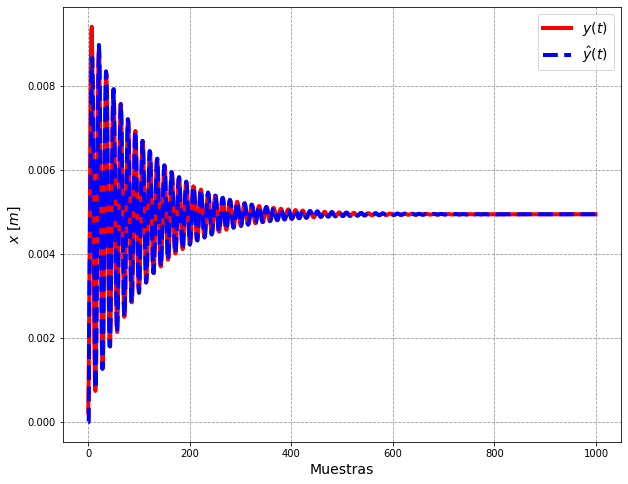

In [13]:
# Código de generación de datos
# Modelo en espacio de estados
A = np.array([[0, 1], [-kn / (m + M), -b / (m + M)]])
B = np.array([[0], [-g]])
C = np.array([[-1, 0]])
D = np.array([[0]])

# Sistema en tiempo continuo. Representación en espacio de estados
sys_cont = signal.StateSpace(A, B, C, D)

# Tiempo de muestreo y discretización
T_s = 0.01
sys_disc = sys_cont.to_discrete(T_s, 'tustin')

# Generando los datos de respuesta al escalón
t = np.arange(0, 10, T_s)  # Tiempo de simulación
__, y = signal.dstep(sys_disc, t=t)  # Respuesta discreta al escalón
y = np.squeeze(y)


# Inicialización de valores para el algoritmo RLS
P = 1000 * np.eye(5)
theta = np.zeros(5)
estimation = [0, 0]
a2 = [0, 0]
coefs = [0, 0]

for k in range (2, len(y)):

    # Definimos el vector de regresión
    phi = np.array([-y[k - 2], -y[k - 1], 1, 1, 1])

    # Error de predicción
    epsilon = y[k] - np.dot(phi.T, theta)

    # Ganancia de Kalman
    K = np.dot(P, phi) / (lambda_ + np.dot(np.dot(phi.T, P), phi))

    # Cálculo de la matriz de covarianza
    P = (1 / lambda_) * (P - (np.dot(np.dot(P, np.outer(phi, phi)), P)) / (lambda_ + np.dot(np.dot(phi.T, P), phi)) )

    # Actualización del vector de parámetros
    theta = theta + (K * epsilon)

    # Guardamos la estimación realizada
    estimation.append(np.dot(phi.T, theta))

    # Estimación de la masa 
    if theta[0] != 0:
        coefs_cont = d2c_bilineal(theta, T_s)
        coefs.append((b_est/coefs_cont[0])-m)

# Gráfica de los datos generados
plt.figure(figsize=(10, 8))
plt.plot(y, 'r-', linewidth=4, label=r'$y(t)$')
plt.plot(estimation, 'b--', linewidth=4, label=r'$\hat{y}(t)$')
plt.grid(True, linestyle='--', color=(0.6, 0.6, 0.6))
plt.xlabel('Muestras', fontsize=14)
plt.ylabel(r'$x\ [m]$', fontsize=14)
plt.legend(fontsize=14)
plt.show()

En la imagen anterior se puede observar el desplazamiento producido debido a la masa $M$ de 237 g. A continuación, se presenta la estimación de la masa $M$ en el régimen estacionario y, en la siguiente imagen, la evolución de dicha estimación a lo largo del tiempo.

In [14]:
display(Math(f"\\text{{Masa estimada }} \\hat{{M}} : {coefs[len(coefs)-1]:.8f} \\; \\left[ kg \\right]"))
display(Math(f"\\text{{Masa real }} M : {M:.8f} \\; \\left[ kg \\right]"))
error_m = abs((M - coefs[len(coefs)-1]) / M) * 100
display(Math(f"\\text{{Error de la masa  }} M: {error_m:.8f}\\%"))

<IPython.core.display.Math object>

<IPython.core.display.Math object>

<IPython.core.display.Math object>

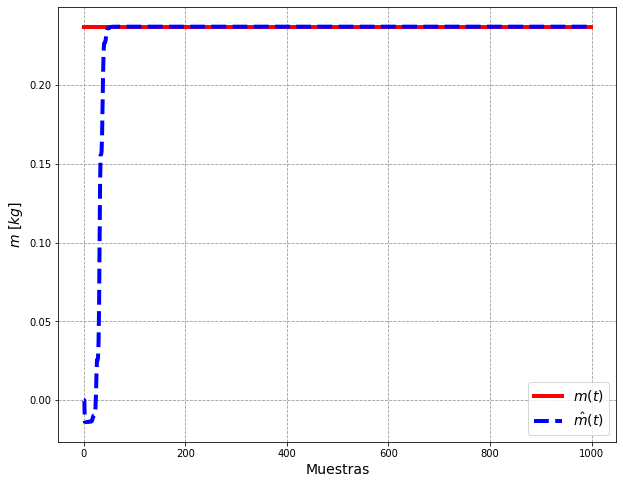

In [15]:
# Gráfica de los datos generados
mass = M * np.ones(len(y))

plt.figure(figsize=(10, 8))
plt.plot(mass, 'r-', linewidth=4, label=r'$m(t)$')
plt.plot(coefs, 'b--', linewidth=4, label=r'$\hat{m}(t)$')
plt.grid(True, linestyle='--', color=(0.6, 0.6, 0.6))
plt.xlabel('Muestras', fontsize=14)
plt.ylabel(r'$m\ [kg]$', fontsize=14)
plt.legend(fontsize=14)
plt.show()

Utilizando este método, podemos observar, como el sensor es capaz de estimar la masa $M$, incluso cuando la salida se encuentra aún en estado transitorio, ya que al sensor le toma menos de 100 muestras llegar a una estimación precisa, mientras que utilizando únicamente una ganancia estática, se necesitarían cerca de 600 muestras para obtener un valor relativamente preciso.

Finalmente, se realiza una recapitulación de lo realizado hasta el momento:

1. Se llevó a cabo una identificación paramétrica en tiempo discreto de un sistema dinámico mediante el algoritmo RLS con factor de olvido. Este proceso se puede interpretar como la caracterización de nuestra galga extensiométrica u obtener un modelo discreto del sensor.
2. Mediante un proceso de identificación directa, se recuperó el modelo en tiempo continuo y la magnitud física de los parámetros del sistema dinámico. Bajo otro enfoque, se ejecutó un proceso de calibración del sensor para conocer los parámetros físicos del modelo dinámico en tiempo continuo.
3. Se utilizó una expresión matemática para obtener la masa de entrada al sensor, dicha expresión relaciona la masa de entrada con un coeficiente que se puede estimar gracias al algoritmo RLS.



En conclusión, un simple sensor como la galga extensiométrica, que es sensible a deformaciones y estas son proporcionales al desplazamiento producido debido a la masa, es capaz de estimar la masa de entrada con precisión y rapidez. Además, es capaz de estimar otros parámetros físicos del sensor. Aunque en este caso dichos parámetros no tienen gran utilidad, si trasladamos este enfoque a otros sistemas dinámicos, con una simple medición, nuestro sensor podría estimar múltiples parámetros físicos con precisión y velocidad. De este modo, es posible dotar a un simple sensor de **inteligencia**.



En el siguiente capitulo se presenta una aplicación donde mediante los mínimos cuadrados recursivos es posible recuperar el valor de la entrada  de una manera más eficiente y sin necesidad de conocer el modelo del sensor. 